# Dx score

```{contents}
```

## Load data

In [1]:
import pandas as pd
import sys
sys.path.append('../')
from source.pacmap_functions import *

# mount = '../../../'
mount = '/mnt/f/'
input_path = mount + 'MethylScore/Intermediate_Files/'
output_path = mount + 'MethylScore/Processed_Data/'

# read df_discovery and df_validation
df_discovery = pd.read_pickle(
    input_path+'3308samples_333059cpgs_withbatchcorrection_bvalues.pkl').sort_index()

df_validation = pd.read_pickle(
    input_path+'201samples_357839cpgs_withbatchcorrection_bvalues.pkl').sort_index()

# Load clinical data
discovery_clinical_data = pd.read_csv(input_path+'discovery_clinical_data.csv',
                                      low_memory=False, index_col=0)

# Load clinical data
validation_clinical_data = pd.read_csv(input_path+'validation_clinical_data.csv',
                                        low_memory=False, index_col=0)

# Adjust clinical data
discovery_clinical_data['Train Test'] = 'Discovery (train) Samples'
validation_clinical_data['Train Test'] = 'Validation (test) Samples'

discovery_clinical_data['PaCMAP Output'] = 'Patient Samples'
validation_clinical_data['PaCMAP Output'] = 'Patient Samples'

discovery_clinical_data['Batch'] = df_discovery['Batch']
validation_clinical_data['Batch'] = 'St Jude Children\'s'


## Select CpGs in both train and test

In [2]:
# use overlapping features between df_discovery and df_validation
common_features = [x for x in df_discovery.columns if x in df_validation.columns]

# apply `common_features` to both df_discovery and df_validation
df_discovery = df_discovery[common_features]
df_validation = df_validation[common_features]

print(
f' Discovery dataset (df_discovery) contains {df_discovery.shape[1]} \
columns (5mC nucleotides/probes) and {df_discovery.shape[0]} rows (samples).')

print(
f' Validation dataset (df_validation) contains {df_validation.shape[1]} \
columns (5mC nucleotides/probes) and {df_validation.shape[0]} rows (samples).')

output_notebook()

# Set the theme for the plot
curdoc().theme = 'dark_minimal' # or 'dark_minimal'

 Discovery dataset (df_discovery) contains 319558 columns (5mC nucleotides/probes) and 3308 rows (samples).
 Validation dataset (df_validation) contains 319558 columns (5mC nucleotides/probes) and 201 rows (samples).


Loading BokehJS ...

## Acute Leukemia Methylome Atlas

In [3]:
# clinical_trials = [
#                     'NOPHO ALL92-2000', 
#                     'AAML0531',
#                     'AAML1031',
#                     'Beat AML Consortium',
#                     'TCGA AML',
#                     'CETLAM SMD-09 (MDS-tAML)',
#                     'French GRAALL 2003–2005',
#                     'TARGET ALL',
#                     'AAML03P1',
#                     'Japanese AML05',
#                     'CCG2961']

# sample_types = ['Diagnosis', 'Primary Blood Derived Cancer - Bone Marrow',
#                 'Bone Marrow Normal','Primary Blood Derived Cancer - Peripheral Blood',
#                 'Blood Derived Normal','Peripheral Blood Normal',
#                 # 'Relapse','Recurrent Blood Derived Cancer - Bone Marrow',
#                 # 'Recurrent Blood Derived Cancer - Peripheral Blood',
#                 ]

# cols = ['Clinical Trial', 'Sample Type', 'Patient_ID', 'WHO 2022 Diagnosis', 'Train Test', 'Batch', 'Hematopoietic Entity']

# components = [2,5]
# for n in components:
#     processor = DataProcessor(discovery_clinical_data.copy(),
#                               df_discovery,
#                               clinical_trials,
#                               sample_types,
#                               cols, 
#                               n_components=n,
#                               common_prefix=output_path+f'pacmap_output/pacmap_{n}d_model_acute_leukemia', 
#                               df_test=df_validation.copy(),
#                               test_clinical_data=validation_clinical_data.copy())
    
#     processor.filter_data()
#     processor.apply_pacmap() # learn PaCMAP on the training data
#     processor.apply_pacmap_test() # apply PaCMAP to the test data
#     processor.join_labels()

#     # Save output
#     processor.df.to_csv(output_path+f'pacmap_output/pacmap_{n}d_output_acute_myeloid_leukemia.csv')


# df = pd.read_csv(output_path+'pacmap_output/pacmap_2d_output_acute_myeloid_leukemia.csv', index_col=0)

In [4]:
# # Concatenate discovery and validation clinical data
# clinical_data = pd.concat([discovery_clinical_data, validation_clinical_data]).loc[df['index']]

# # Select columns to plot
# cols = ['PaCMAP Output','Hematopoietic Entity','WHO 2022 Diagnosis',
#         'Age (group years)', 'Batch', 'Sex', 'Trisomy 8 Status',
#         'Clinical Trial', 'Sample Type', 'Train Test']

# # Join clinical data to the embedding
# df = df.join(clinical_data[cols], rsuffix='_copy', on='index')

# # Call the BokehPlotter class to plot the data
# plotter = BokehPlotter(df, cols, get_custom_color_palette(), 
#                        title='',
#                        x_range=(-45, 45), y_range=(-45, 45),
#                        datapoint_size=4, width=1000, height=600,
#                        )
# plotter.plot()

## AML Methylome Atlas

In [5]:
discovery_clinical_data['ELN 2022 Diagnosis'].value_counts()

ELN 2022 Diagnosis
AML with t(v;11q23); KMT2A-r               324
Otherwise-Normal Control                   251
AML with mutated NPM1                      226
MDS-related; secondary myeloid             219
AML with inv(16); t(16;16); CBFB::MYH11    177
AML with t(8;21); RUNX1::RUNX1T1           176
AML with other recurring translocations    171
AML with mutated CEBPA                      83
APL with t(15;17); PML::RARA                31
AML with t(6;9); DEK::NUP214                27
AML with inv(3); t(3;3); MECOM-r            19
AML with t(9;22); BCR::ABL1                  3
Name: count, dtype: int64

In [6]:
clinical_trials = [
                    'NOPHO ALL92-2000', 
                    'AAML0531',
                    'AAML1031',
                    'Beat AML Consortium',
                    'TCGA AML',
                    'CETLAM SMD-09 (MDS-tAML)',
                    'French GRAALL 2003–2005',
                    'TARGET ALL',
                    'AAML03P1',
                    'Japanese AML05',
                    'CCG2961'
                    ]

sample_types = ['Diagnosis', 'Primary Blood Derived Cancer - Bone Marrow', 'Bone Marrow Normal',
                'Primary Blood Derived Cancer - Peripheral Blood', 'Blood Derived Normal',
                'Relapse','Recurrent Blood Derived Cancer - Bone Marrow',
                'Recurrent Blood Derived Cancer - Peripheral Blood'
                ]

cols = ['Clinical Trial', 'Sample Type', 'Patient_ID', 'WHO 2022 Diagnosis',
        'ELN 2022 Diagnosis','Hematopoietic Entity' ,'Train Test', 'Batch']

components = [2,5]
for n in components:
    processor = DataProcessor(discovery_clinical_data.copy(),
                              df_discovery,
                              clinical_trials,
                              sample_types,
                              cols, 
                              n_components=n,
                              common_prefix=output_path+f'pacmap_output/pacmap_{n}d_model_peds_dx_al', 
                              df_test=df_validation.copy(),
                              test_clinical_data=validation_clinical_data.copy())
    
    processor.filter_data()
    processor.apply_pacmap() # learn PaCMAP on the training data
    processor.apply_pacmap_test() # apply PaCMAP to the test data
    processor.join_labels() # join clinical data to the embedding

    # Save output
    processor.df.to_csv(output_path+f'pacmap_output/pacmap_{n}d_model_dx_al.csv')

The PaCMAP instance is successfully saved at /mnt/f/MethylScore/Processed_Data/pacmap_output/pacmap_2d_model_peds_dx_al.pkl.
To load the instance again, please do `pacmap.load(/mnt/f/MethylScore/Processed_Data/pacmap_output/pacmap_2d_model_peds_dx_al)`.
The PaCMAP instance is successfully saved at /mnt/f/MethylScore/Processed_Data/pacmap_output/pacmap_5d_model_peds_dx_al.pkl.
To load the instance again, please do `pacmap.load(/mnt/f/MethylScore/Processed_Data/pacmap_output/pacmap_5d_model_peds_dx_al)`.


In [7]:
df = pd.read_csv(output_path+'pacmap_output/pacmap_2d_model_dx_al.csv', index_col=0)

# Concatenate discovery and validation clinical data
clinical_data = pd.concat([discovery_clinical_data, validation_clinical_data]).loc[df['index']]

# Select columns to plot
cols = ['WHO 2022 Diagnosis','ELN 2022 Diagnosis','Hematopoietic Entity','FAB', 'FLT3 ITD', 'Age (group years)',
        'Complex Karyotype' ,'Batch', 'Sex', 'MRD 1 Status',
        'Leucocyte counts (10⁹/L)', 'Risk Group', 'Race or ethnic group', 'Trisomy 8 Status',
        'Clinical Trial', 'Vital Status','First Event','Sample Type', 'Train Test']

# Join clinical data to the embedding
df = df.join(clinical_data[cols], rsuffix='_copy', on='index')

plotter = BokehPlotter(df, cols, get_custom_color_palette(),
                       title='',
                        x_range=(-45, 45), y_range=(-45, 45),
                        datapoint_size=4, tooltip_dx_cols='WHO 2022 Diagnosis',
                        width=1000, height=600)
plotter.plot()

## Patient Characteristics Table

In [8]:
from tableone import TableOne

columns = ['Hematopoietic Entity',
            'Clinical Trial',]

df_train = df[df['Train Test']=='Discovery (train) Samples']

mytable_cog = TableOne(df_train.reset_index(), columns,
                        overall=False, missing=False,
                        pval=False, pval_adjust=False,
                        htest_name=True,dip_test=True,
                        tukey_test=True, normal_test=True,

                        order={'FLT3 ITD':['Yes','No'],
                                'Age (group years)':['0-5','5-13','13-39','39-60'],
                                'MRD 1 Status': ['Positive'],
                                'Risk Group': ['High Risk', 'Standard Risk'],
                                'FLT3 ITD': ['Yes'],
                                'Leucocyte counts (10⁹/L)': ['≥30'],
                                'Age group (years)': ['≥10']})

# mytable_cog.to_excel('data/tableone_Dx_pacmap.xlsx')
# mytable_cog.to_csv(output_path + 'pacmap_output/tableone_Dx_pacmap.csv')

mytable_cog.tabulate(tablefmt="html", 
                        # headers=[score_name,"",'Missing','Discovery','Validation','p-value','Statistical Test']
                        )

,,Overall
n,,3047
"Hematopoietic Entity, n (%)",Acute lymphoblastic leukemia (ALL),700 (31.1)
,Acute myeloid leukemia (AML),1206 (53.6)
,Acute promyelocytic leukemia (APL),31 (1.4)
,Mixed phenotype acute leukemia (MPAL),48 (2.1)
,Myelodysplastic syndrome (MDS or MDS-like),136 (6.0)
,Otherwise-Normal (Control),128 (5.7)
"Clinical Trial, n (%)",AAML03P1,72 (2.4)
,AAML0531,628 (20.6)
,AAML1031,581 (19.1)


## Load data for multi-class classifier

In [1]:
import pandas as pd
import numpy as np

input_path = '/mnt/f/MethylScore/Intermediate_Files/'
output_path = '/mnt/f/MethylScore/Processed_Data/'

n_components = 5

# Create a list of strings containing "PaCMAP " + the number of components
components = [f'PaCMAP {i}' for i in range(1, n_components+1)]

# Load pacmap output data
df = pd.read_csv(output_path+f'pacmap_output/pacmap_{n_components}d_model_dx_al.csv', index_col=0)

## Preprocess data

### Select WHO 2022 annotated samples

In [2]:
# drop the samples with missing labels for the ELN AML 2022 Diagnosis
df_original = df.copy()
df = df[~df['ELN 2022 Diagnosis'].isna()]

# drop samples from `df['Hematopoietic Entity']` that contain `ALL` and `MPAL` and `Otherwise-Normal Control` and `APL`
# df = df[df['Hematopoietic Entity'].isin(['Acute myeloid leukemia (AML)'])]

# print the number of samples dropped and the amount remaining
print(df_original.shape[0]-df.shape[0], 'samples removed.'\
, df.shape[0], 'samples remaining.')

1636 samples removed. 1612 samples remaining.


### Select Dx subtypes with at least 10 samples

In [3]:
df['ELN 2022 Diagnosis'].value_counts(dropna=False)

ELN 2022 Diagnosis
AML with t(v;11q23); KMT2A-r               372
AML with mutated NPM1                      228
AML with t(8;21); RUNX1::RUNX1T1           205
AML with inv(16); t(16;16); CBFB::MYH11    200
AML with other recurring translocations    176
MDS-related; secondary myeloid             136
Otherwise-Normal Control                   128
AML with mutated CEBPA                      85
APL with t(15;17); PML::RARA                31
AML with t(6;9); DEK::NUP214                29
AML with inv(3); t(3;3); MECOM-r            19
AML with t(9;22); BCR::ABL1                  3
Name: count, dtype: int64

In [4]:
# exclude the samples with mixed phenotypes and Down syndrome and t(9;22)(q34.1;q11.2)/BCR::ABL1
df2 = df[~df['WHO 2022 Diagnosis'].isin([
                                    # 'MPAL with t(v;11q23.3)/KMT2A-r',
                                    #    'B-ALL with hypodiploidy',
                                       'AML with t(9;22); BCR::ABL1'])]

# print the number of samples dropped and the amount remaining
print(df.shape[0]-df2.shape[0], 'samples removed.'\
, df2.shape[0], 'samples remaining, which includes 111 test samples')
                                       

3 samples removed. 1609 samples remaining, which includes 111 test samples


### Define X and y

In [5]:

# Define X and y
X = df2[components].to_numpy() # shape (n_samples=1399, n_features=5)
y = df2['ELN 2022 Diagnosis'].to_numpy() # shape (n_samples=1399,) with 11 string classes

# Split the data into train/test sets based on the `Train Test` column
X_train = X[df2['Train Test']=='Discovery (train) Samples']
y_train = y[df2['Train Test']=='Discovery (train) Samples']
X_test = X[df2['Train Test']=='Validation (test) Samples']
y_test = y[df2['Train Test']=='Validation (test) Samples']

# print the number of samples in each set
print('X_train shape:', X_train.shape, 'X_test shape:', X_test.shape)

X_train shape: (1498, 5) X_test shape: (111, 5)


## LightGBM

### 5 components

In [8]:
from sklearn.model_selection import GridSearchCV, StratifiedKFold
from lightgbm import LGBMClassifier
from sklearn.metrics import accuracy_score
import sys

sys.path.append('../')
from source.data_visualization_functions import plot_confusion_matrix_stacked

# param_grid = {}

# Define the parameter grid
param_grid = {
    'num_leaves': [100], # number of leaves in full tree, which will roughly be the same as max number of features in one-hot encoding
    'learning_rate': [0.01],  # learning rate
    'n_estimators': [200],  # number of trees (or rounds)
}

# param_grid = {
#     'num_leaves': [7,15,30, 50, 100], # number of leaves in full tree, which will roughly be the same as max number of features in one-hot encoding
#     'learning_rate': [0.01, 0.05, 0.1, 0.2],  # learning rate
#     'n_estimators': [30, 50, 100, 200, 300]  # number of trees (or rounds)
# }

# Initialize the LGBM Classifier
lgbm = LGBMClassifier(random_state=42, n_jobs=-1)

# Initialize StratifiedKFold
stratified_kfold = StratifiedKFold(n_splits=10, shuffle=True, random_state=42, )

# Perform grid search with stratified cross-validation
grid_search = GridSearchCV(lgbm, param_grid, cv=10, n_jobs=-1, scoring='roc_auc_ovr_weighted', verbose=0)
grid_search.fit(X_train, y_train)

# Print the best parameters and the best score
print(f"Best parameters: {grid_search.best_params_}")
print(f"Best cross-validation score (not final): {grid_search.best_score_:.3f}")

# Fit and predict using the best estimator
best_model = grid_search.best_estimator_

y_pred_train = best_model.predict(X_train)  # Predict using the best model
y_pred_test = best_model.predict(X_test)  # Predict using the best model


print(f'Overall accuracy score with best estimator in train: {accuracy_score(y_train, y_pred_train):.3f}')
print(f'Overall accuracy score with best estimator in test: {accuracy_score(y_test, y_pred_test):.3f}')

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.028653 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.020769 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [Info] Number of data points in the train set: 1348, number of used features: 5
[LightGBM] [Info] Number of data points in the train set: 1348, number of used features: 5
[LightGBM] [Info] Start training from score -2.131203
[LightGBM] [Info] Start training from score -2.131203
[LightGBM] [Info] Start training from score -4.373164
[LightGBM] [Info] Start training from score -4.373164
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.034506 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1275
[LightGBM] [In

In [ ]:

plot_confusion_matrix_stacked(best_model, X_train, y_train, X_test, y_test,
                              tick_fontsize=7, label_fontsize=7, figsize = (10,5))


NameError: name 'plot_confusion_matrix_stacked' is not defined

## Gaussian Process Classifier

Best parameters: {'multi_class': 'one_vs_rest'}
Best cross-validation score: 0.950
Overall accuracy score with best estimator in train: 0.844
Overall accuracy score with best estimator in test: 0.892


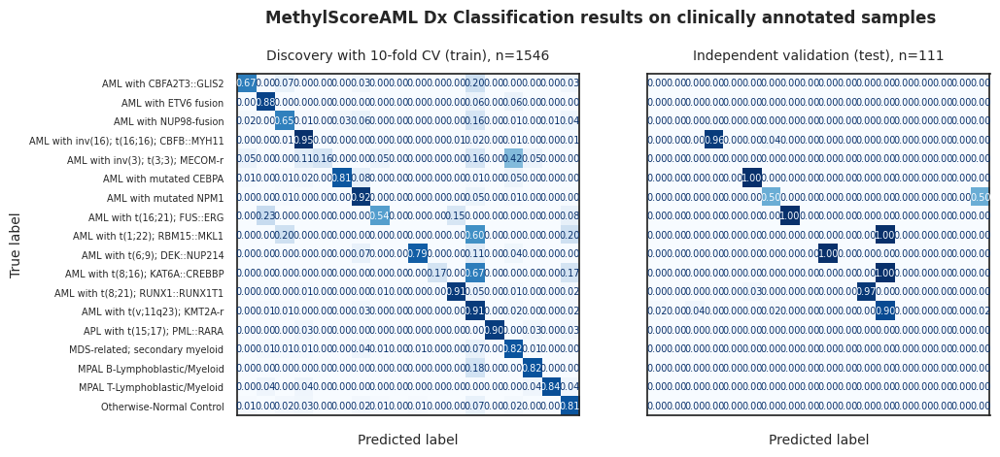

In [14]:
from sklearn.gaussian_process import GaussianProcessClassifier

# Define the parameter grid
param_grid = {
    'multi_class': ['one_vs_rest'],  # one_vs_rest is the only option for multi-class classification
}

# Initialize the Gaussian Process Classifier
gpc = GaussianProcessClassifier(random_state=42, n_jobs=-1)

# Perform grid search with cross-validation
grid_search = GridSearchCV(gpc, param_grid, cv=10, n_jobs=-1, scoring='roc_auc_ovr_weighted')
grid_search.fit(X_train, y_train)

# Fit and predict using the best estimator
best_model = grid_search.best_estimator_

y_pred = best_model.predict(X_test)  # Predict using the best model

# Print the best parameters and the best score
print(f"Best parameters: {grid_search.best_params_}")
print(f"Best cross-validation score: {grid_search.best_score_:.3f}")

# Fit and predict using the best estimator
best_model = grid_search.best_estimator_

y_pred_train = best_model.predict(X_train)  # Predict using the best model
y_pred_test = best_model.predict(X_test)  # Predict using the best model


print(f'Overall accuracy score with best estimator in train: {accuracy_score(y_train, y_pred_train):.3f}')
print(f'Overall accuracy score with best estimator in test: {accuracy_score(y_test, y_pred_test):.3f}')

plot_confusion_matrix_stacked(best_model, X_train, y_train, X_test, y_test,
                              tick_fontsize=7, label_fontsize=7, figsize = (10,5))


## Random Forest Classifier

Best parameters: {'max_depth': 10, 'n_estimators': 200}
Best cross-validation score: 0.958
Overall accuracy score with best estimator in train: 0.904
Overall accuracy score with best estimator in test: 0.892


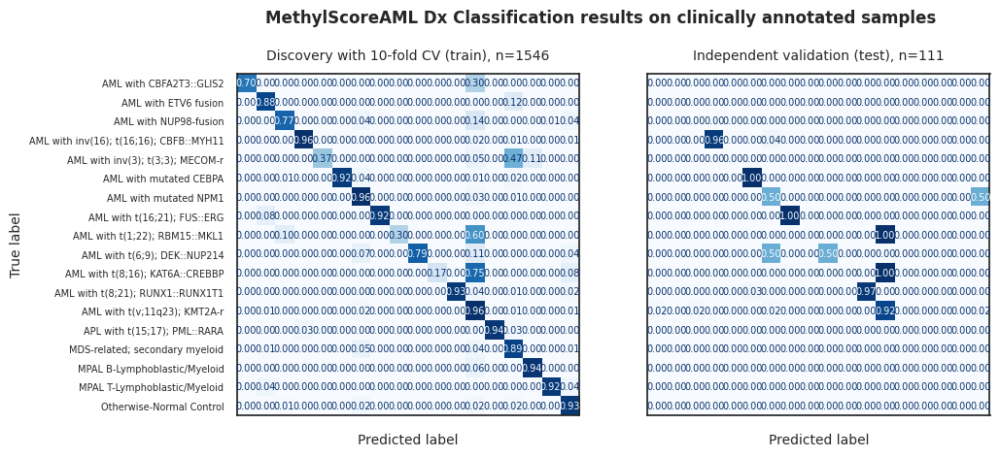

In [15]:
from sklearn.ensemble import RandomForestClassifier

# Define the parameter grid
param_grid = {
    'n_estimators': [10, 50, 100, 200],  # number of trees in the forest
    'max_depth': [None, 5, 10, 20, 50],  # maximum depth of the tree

}

# Initialize the Random Forest Classifier
rf = RandomForestClassifier(random_state=42, n_jobs=-1)

# Perform grid search with cross-validation
grid_search = GridSearchCV(rf, param_grid, cv=10, n_jobs=-1, scoring='roc_auc_ovr_weighted')
grid_search.fit(X_train, y_train)

# Print the best parameters and the best score
print(f"Best parameters: {grid_search.best_params_}")
print(f"Best cross-validation score: {grid_search.best_score_:.3f}")

# Fit and predict using the best estimator
best_model = grid_search.best_estimator_

y_pred_train = best_model.predict(X_train)  # Predict using the best model
y_pred_test = best_model.predict(X_test)  # Predict using the best model


print(f'Overall accuracy score with best estimator in train: {accuracy_score(y_train, y_pred_train):.3f}')
print(f'Overall accuracy score with best estimator in test: {accuracy_score(y_test, y_pred_test):.3f}')

plot_confusion_matrix_stacked(best_model, X_train, y_train, X_test, y_test,
                              tick_fontsize=7, label_fontsize=7, figsize = (10,5))



## Watermark

In [16]:
%load_ext watermark

In [17]:
# watermark with all libraries used in this notebook
%watermark -v -p numpy,pandas,bokeh,pacmap,itables -a Francisco_Marchi@Lamba_Lab_UF -d -m

Author: Francisco_Marchi@Lamba_Lab_UF

Python implementation: CPython
Python version       : 3.8.16
IPython version      : 8.12.2

numpy  : 1.24.3
pandas : 2.0.2
bokeh  : 3.1.1
pacmap : 0.7.0
itables: 1.5.2

Compiler    : GCC 11.3.0
OS          : Linux
Release     : 5.15.133.1-microsoft-standard-WSL2
Machine     : x86_64
Processor   : x86_64
CPU cores   : 20
Architecture: 64bit

